# Densidad Poblacional

*Realizamos el cálculo del número de frailejones y la densidad poblacional para los modelos de red multicapa y VGG16 como se muestra a continuación*

## Red Multicapa

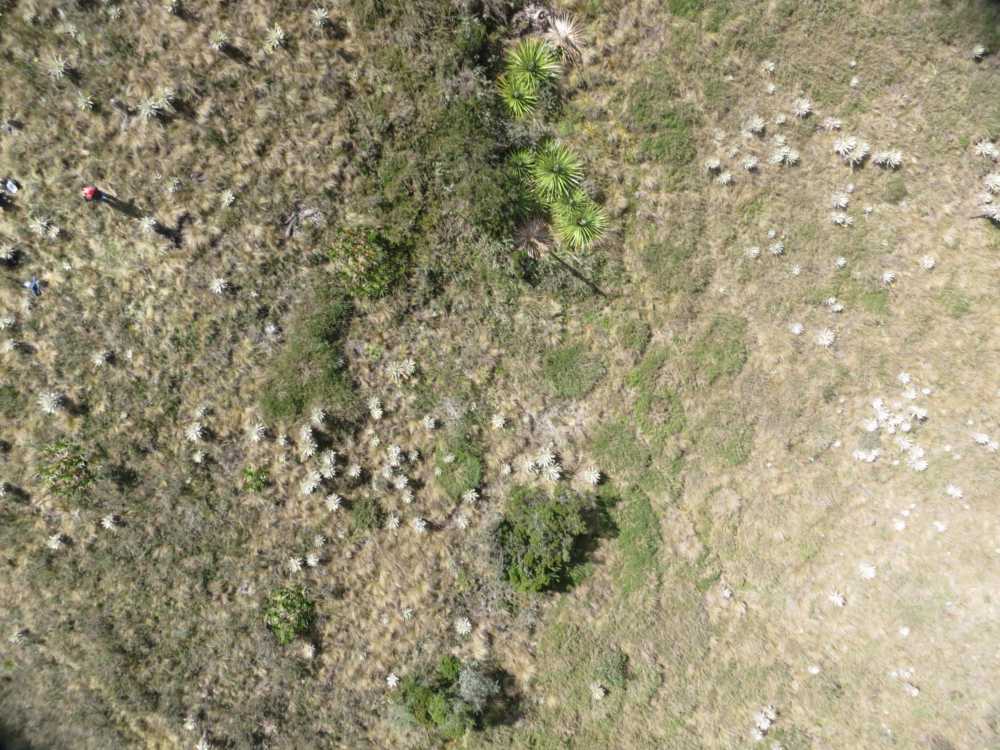

In [1]:
#Importamos la imagen de la prueba cualitativa
from tensorflow.keras.utils import load_img
import urllib
import matplotlib.pyplot as plt

urllib.request.urlretrieve('https://github.com/sergiomora03/AdvancedTopicsAnalytics/blob/main/notebooks/img/IMG_3451.JPG?raw=true', 'IMG_3451.JPG')
img = load_img('IMG_3451.JPG')
img

In [3]:
#Cargamos el modelo al notebook 
from tensorflow.keras.models import load_model
red_multicapa = load_model('modelo_Red_Multicapa.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


C:\Users\Acer\AppData\Local\Temp\ipykernel_21656\3268212633.py:31: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_P = int(red_multicapa.predict(vec.T) > 0.5)  # 1 si es frailejón, 0 si no


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━

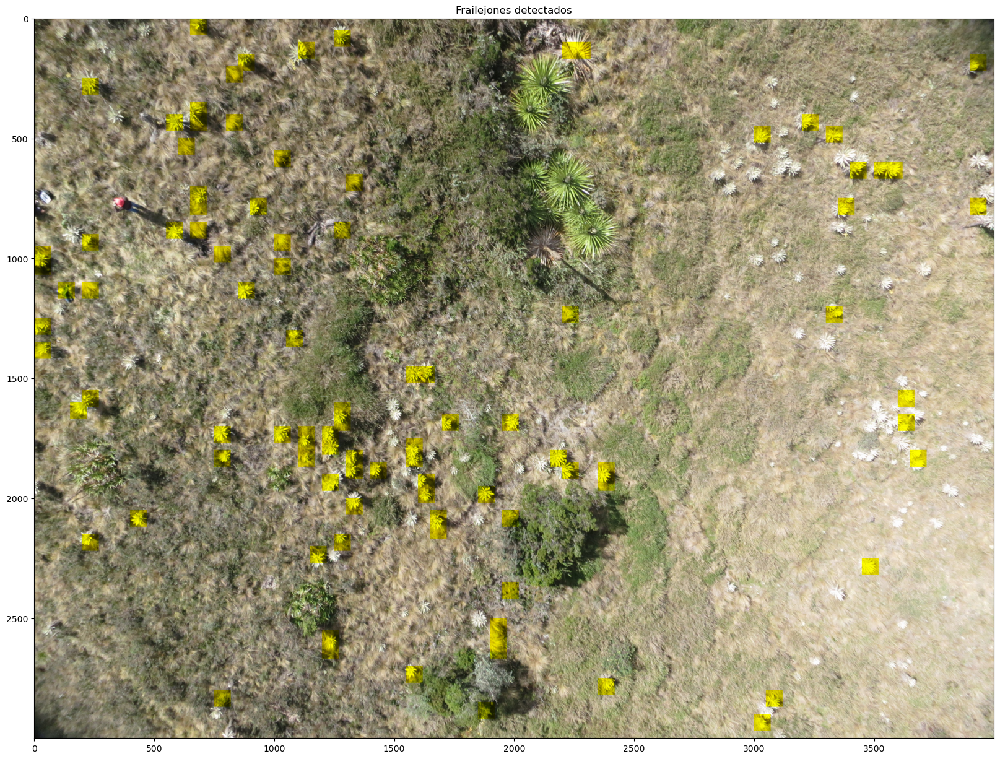

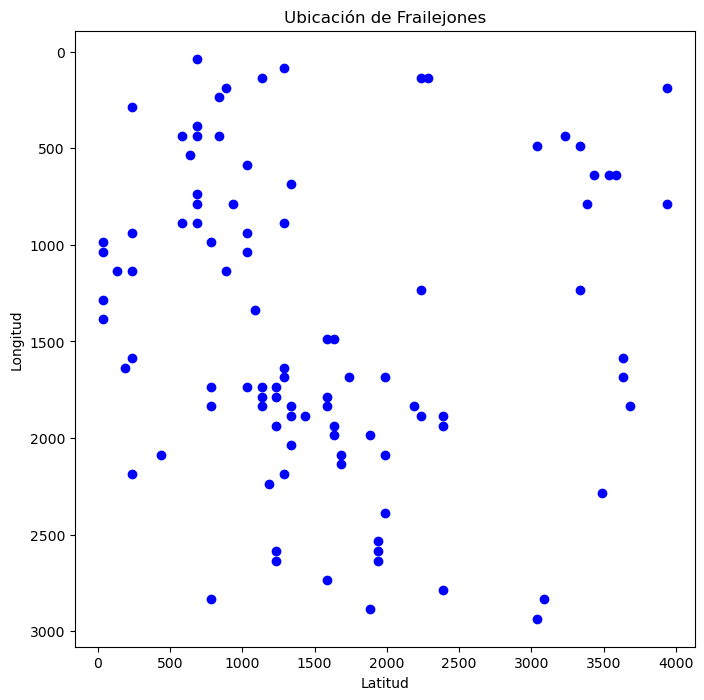

c:\Users\Acer\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


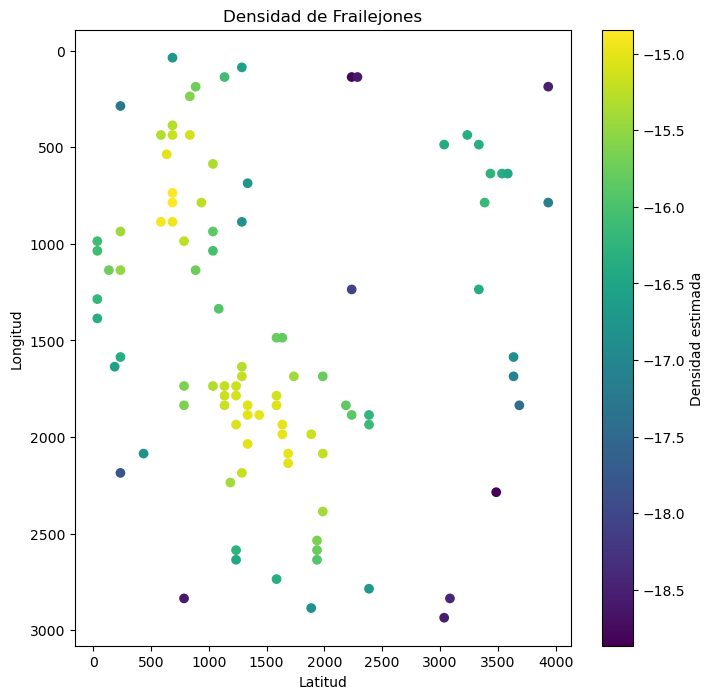

Número total de frailejones detectados: 97


In [4]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture

# Convertir la imagen a un array de numpy
x = np.array(img)
x2 = x.copy()

# Array para guardar coordenadas
frailejon_coords = []

# Dimensiones de la imagen
ni = x.shape[0] - 50
mi = x.shape[1] - 50

# Iniciar variables
f1 = 0
f2 = 70

# Loop para recorrer la imagen en bloques
for i in range(1, ni, 50):
    c1 = 0
    c2 = 70
    for j in range(1, mi, 50):
        subi = x[f1:f2, c1:c2, :]
        subi2 = np.ndarray.flatten(subi).T / 255.
        ns = subi2.shape[0]
        vec = subi2.reshape((ns, 1))

        # Predicción del modelo
        pred_P = int(red_multicapa.predict(vec.T) > 0.5)  # 1 si es frailejón, 0 si no

        # Si se detecta un frailejón
        if pred_P == 1:
            x2[f1:f2, c1:c2, 2] = 0  
            # Guardar las coordenadas del centro del bloque
            # Usamos 35 para centrar el punto en el bloque
            frailejon_coords.append([i + 35, j + 35])

        #Revisar el siguiente bloque
        c1 += 50
        c2 += 50

    f1 += 50
    f2 += 50

#Prueba cualitativa - Frailejones detectados
plt.figure(figsize=(20, 20))
plt.imshow(x2)
plt.title('Frailejones detectados')
plt.show()

# Convertir las coordenadas a un array de numpy para hacer el scatter plot
frailejon_coords = np.array(frailejon_coords)

# Graficar scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], color='blue')  # Intercambiar los ejes para alinearlos
plt.gca().invert_yaxis()  # Invertir el eje Y para que coincida con la imagen
plt.title('Ubicación de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

# Calcular densidad usando GMM
gmm = GaussianMixture(n_components=3, covariance_type='full')
gmm.fit(frailejon_coords)

# Obtener las densidades estimadas
densidades = gmm.score_samples(frailejon_coords)

# Grafico de la densidad
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], c=densidades, cmap='viridis')  # Intercambiar los ejes
plt.gca().invert_yaxis()  # Invertir el eje Y
plt.colorbar(label='Densidad estimada')
plt.title('Densidad de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

#Número de frailejones detectados
num_frailejones = len(frailejon_coords)
print(f'Número total de frailejones detectados: {num_frailejones}')

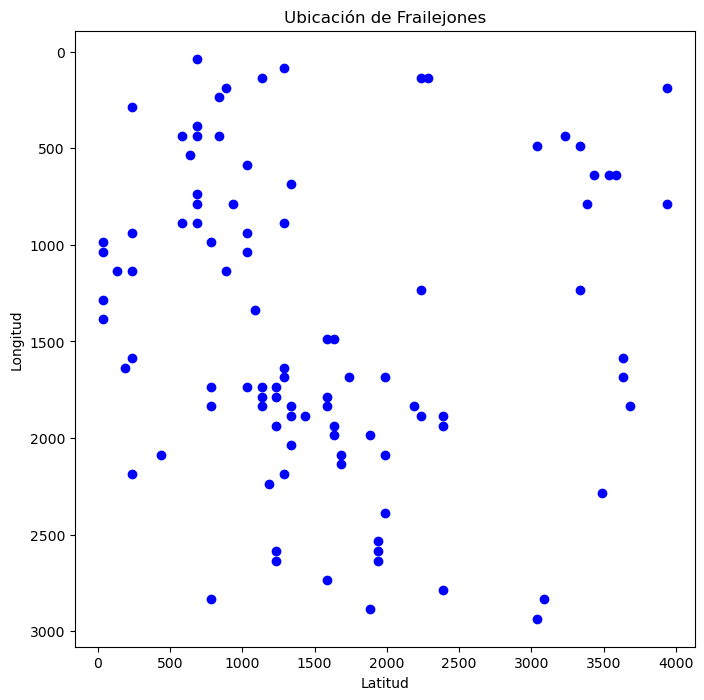

c:\Users\Acer\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


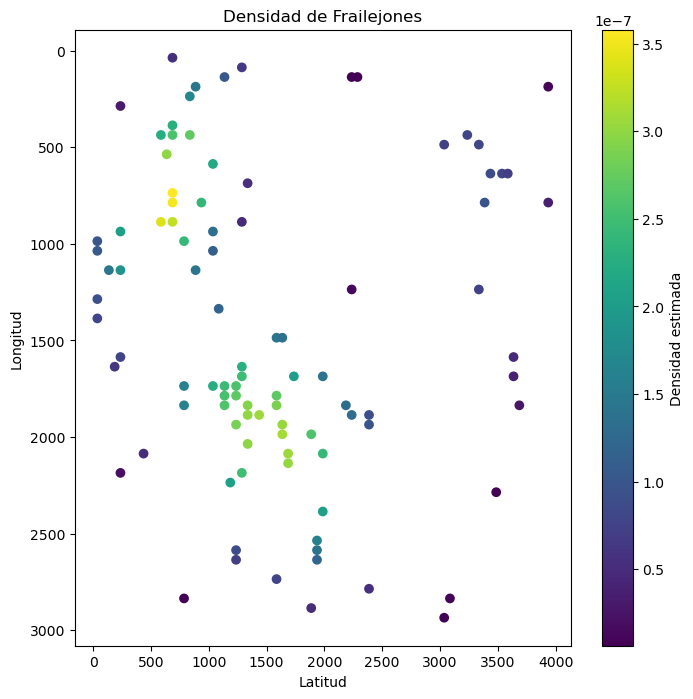

Número total de frailejones detectados: 97


In [5]:
# Graficar scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], color='blue')  # Intercambiar los ejes para alinearlos
plt.gca().invert_yaxis()  # Invertir el eje Y para que coincida con la imagen
plt.title('Ubicación de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

# Calcular densidad usando GMM
gmm = GaussianMixture(n_components=3, covariance_type='full')
gmm.fit(frailejon_coords)

# Obtener las densidades estimadas
log_densidades = gmm.score_samples(frailejon_coords)
densidades = np.exp(log_densidades)

# Grafico de la densidad
plt.figure(figsize=(8, 8))
plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], c=densidades, cmap='viridis')  # Intercambiar los ejes
plt.gca().invert_yaxis()  # Invertir el eje Y
plt.colorbar(label='Densidad estimada')
plt.title('Densidad de Frailejones')
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

#Número de frailejones detectados
num_frailejones = len(frailejon_coords)
print(f'Número total de frailejones detectados: {num_frailejones}')

c:\Users\Acer\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
C:\Users\Acer\AppData\Local\Temp\ipykernel_21656\216327096.py:27: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(data[:, 0], data[:, 1], s=50, c='green', cmap='viridis', alpha=0.7)


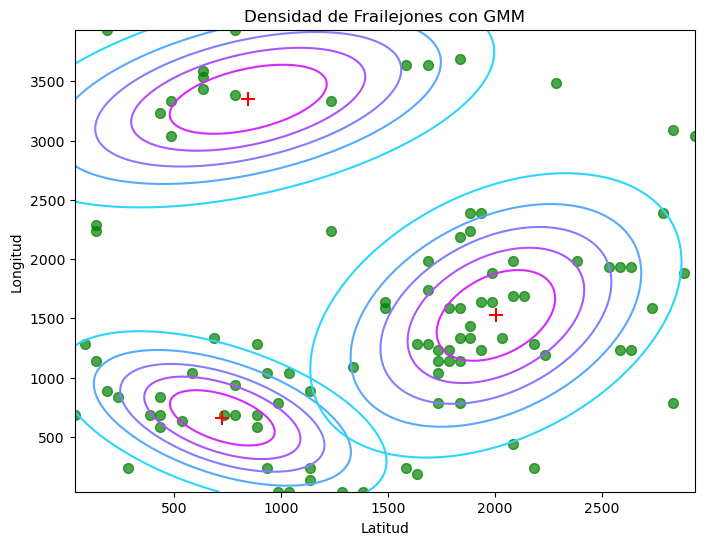

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from scipy.stats import multivariate_normal


data = frailejon_coords

# Verificar cuántos puntos hay en el conjunto de datos
n_samples = data.shape[0]

# Ajustar el número de componentes según el número de muestras
n_components = min(3, n_samples)  # Asegura que no haya más componentes que puntos

# Ajustar un modelo GMM con 'n_components' componentes
gmm = GaussianMixture(n_components=n_components, covariance_type='full').fit(data)

# Crear una cuadrícula de puntos para graficar las distribuciones de los clústeres
x, y = np.meshgrid(np.linspace(data[:, 0].min(), data[:, 0].max(), 500),
                   np.linspace(data[:, 1].min(), data[:, 1].max(), 500))
xy = np.column_stack([x.flat, y.flat])

# Crear la figura
plt.figure(figsize=(8, 6))

# Graficar los puntos de datos (latitud y longitud)
plt.scatter(data[:, 0], data[:, 1], s=50, c='green', cmap='viridis', alpha=0.7)

# Para cada clúster, calcular y graficar el contorno
for i in range(gmm.n_components):
    mean = gmm.means_[i]
    cov = gmm.covariances_[i]
    z = multivariate_normal(mean=mean, cov=cov).pdf(xy).reshape(x.shape)
    
    # Graficar los contornos de las distribuciones de los clústeres
    plt.contour(x, y, z, levels=np.linspace(z.min(), z.max(), 7), cmap='cool')

    # Graficar la media de cada clúster
    plt.scatter(mean[0], mean[1], c='red', s=100, marker='+')

# Añadir título y etiquetas
plt.title('Densidad de Frailejones con GMM')
#plt.scatter(frailejon_coords[:, 1], frailejon_coords[:, 0], color='blue')  # Intercambiar los ejes para alinearlos
#plt.gca().invert_yaxis()  # Invertir el eje Y
plt.xlabel('Latitud')
plt.ylabel('Longitud')
plt.show()

In [20]:
from scipy.stats import multivariate_normal
for i in range(gmm.n_components):    
    mean = gmm.means_[i]    
    cov = gmm.covariances_[i]    
    cluster_density = multivariate_normal(mean=mean, cov=cov).pdf(frailejon_coords)    
    densidad_promedio_cluster = np.mean(cluster_density)
    print(f"Densidad para el clúster {i}: ", densidad_promedio_cluster)

Densidad para el clúster 0:  1.7574895889036337e-07
Densidad para el clúster 1:  1.7558871644098333e-07
Densidad para el clúster 2:  5.186005853362889e-08
